# Introduction
## Prerequisites
* Install the pytorch's facenet library using `!pip install facenet-pytorch`
* Download [lightning](https://tfhub.dev/google/movenet/singlepose/lightning/4) version of the movenet model from the TF hub.
* Good to enable GPU as the inference is a little faster on it.

## Step 0: Notebook Initialization

In [2]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
import time
import os
from tqdm.notebook import tqdm
from collections import defaultdict

import numpy as np
import pandas as pd

import seaborn as sns
from matplotlib import pyplot as plt
import matplotlib.ticker as ticker
import matplotlib

import cv2 as cv
import torch
from torch.utils.data import DataLoader
from torchvision import transforms

import transformers
import eda_helpers
import feature_helpers
import viz
import configuration
import customdataset
import enums

device = 'cpu'
config = configuration.Configuration()
face_config = configuration.FaceConfig(config)
pose_config = configuration.PoseConfig(config)
vizualizer = viz.Vizualizer(config, face_config, pose_config, tqdm=tqdm)
feature_extractor = feature_helpers.FeatureExtractor(config, face_config, pose_config, tqdm)

IMAGE_TYPES = [enums.ImageTypes.ORIGINAL, enums.ImageTypes.POSE, enums.ImageTypes.FACE]

2022-12-07 21:02:55.409067: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


## Step 1: Understanding The Data
As can be seen in the below plot, we have about 2000 images for each of the 10 classes.

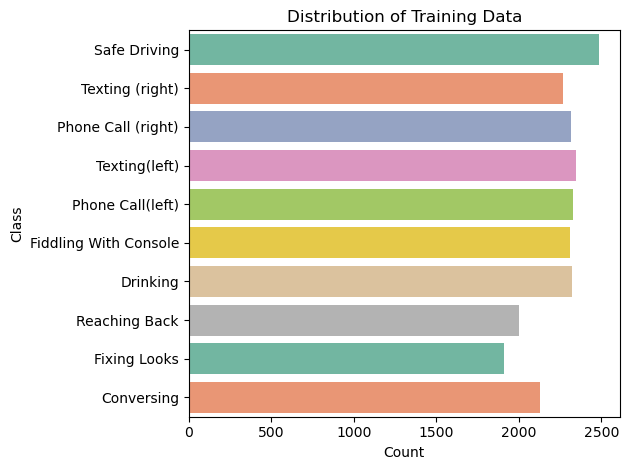

In [238]:
vizualizer.plot_raw_class_counts()

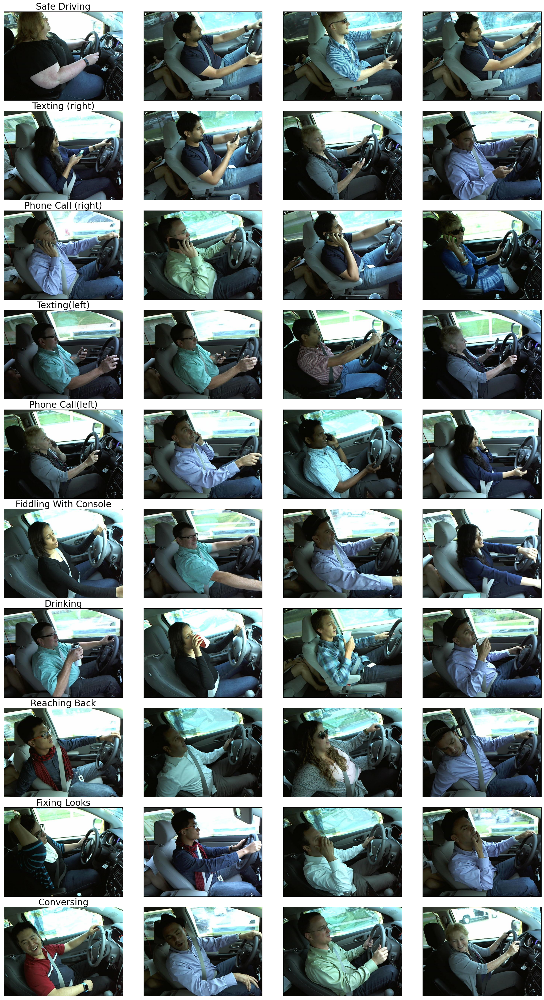

In [239]:
vizualizer.plot_samples(4)

## Step 2: Face Detection
We will use pre-trained Multi-task Cascaded Convolutional Networks model[<sup>1</sup>](#cite_mtcnn) to extract faces from our images. The MTCNN model uses 3 stages:
* Stage 1: The Proposal Network (P-Net), a fully connected network, that predicts bounding boxes around faces in the image
* Stage 2: The Refine Network (R-Net), a CNN with dense layer to predict if the boxes identified by P-Net has a face or not
* Stage 3: The Output Network (O-Net), another CNN that outputs the 5 facial keypoints.


In [244]:
%%time
# Extract face from each image. Takes a few hours to run.
def extract_faces():
    eda_helpers.FaceExtractor(config, tqdm).extract_faces(face_config.FEATURES_FOLDER, face_config.FACE_SUMMARY_NAME, config.ANNOTATION_FILE)
# extract_faces() # Commented out as this takes a long time to run on our 20,000+ images.

CPU times: user 4 µs, sys: 3 µs, total: 7 µs
Wall time: 11.9 µs


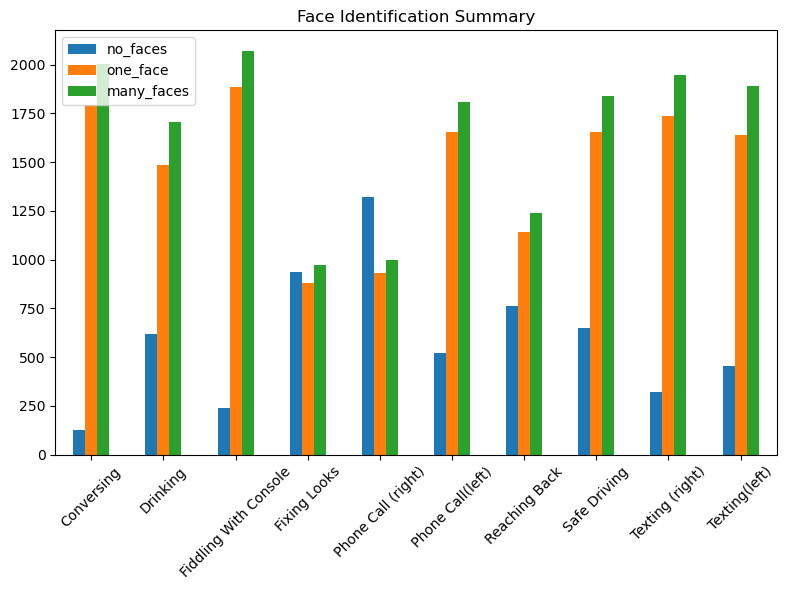

In [243]:
vizualizer.plot_faces_summary()

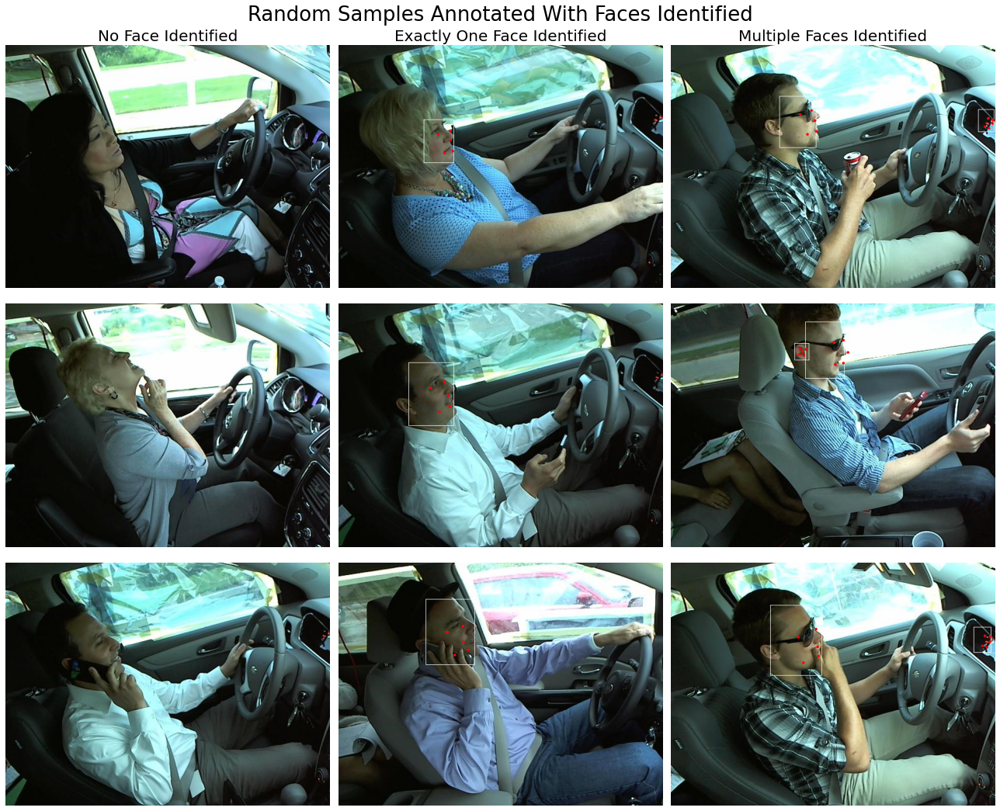

In [247]:
# Display the results of face detection.
vizualizer.display_faces(per_group_count = 3)

### No. Of Eyes Identified

## Step 3: Train-Test-Validation Split
Our training dataset has 22,000+ 640x480x3 color images. In order to iterate faster, we decided to limit the dataset to only those images for which MTCNN model was able to identify faces. This brought our data set to about 600 images per class. We applied 80-20-20 split and created the train-validation-test splits. This also helped make our next step of pose detection more manageable.

In [63]:
def split_dataset():
    splitter = eda_helpers.SampleSplitter(config, face_config, pose_config, tqdm=tqdm)
    splitter.sample(config.class_dict.keys(), samples_per_class=[600, 480, 60, 60], out_file=config.ANNOTATION_FILE)

# split_dataset() # We have commented this code out as this is an one time task.

Total samples: 22424


Processing img_79074.jpg: : 6010it [00:10, 586.01it/s]                                                                                                                                      


Validating and saving the split-up...
Created 4800 training samples
Created 600 validation samples
Created 600 testing samples
Left with 16424 unused samples


## Step 4: Pose Detection For Train-Test-Validation Splits
Our intution is that the pose of the driver can be used to differentiate the classes. In order to build pose based features we want to extract human pose from the images using Google's [Movenet model](https://www.tensorflow.org/hub/tutorials/movenet) which is based on MobileNetV2[<sup>2</sup>](#cite_mobilenet).

In [8]:
%%time
def extract_pose():
    original_backend = matplotlib.get_backend()
    print(f'Switching MatPlotLib backend from {original_backend} to Agg')
    # Pose extraction uses plt's canvas. We need a non-interactive backend to avoid memory leaks.
    matplotlib.use('Agg')
    pose_extractor = eda_helpers.PoseExtractor(config, face_config, pose_config, tqdm)
    pose_extractor.extract_poses(pose_config.FEATURES_FOLDER, pose_config.SUMMARY_NAME)
    matplotlib.use(original_backend)

# extract_pose()

Switching MatPlotLib backend from agg to Agg
Loading model...


  0%|          | 0/6000 [00:00<?, ?it/s]

CPU times: user 1h 28min 2s, sys: 14min 45s, total: 1h 42min 47s
Wall time: 1h 42min 8s


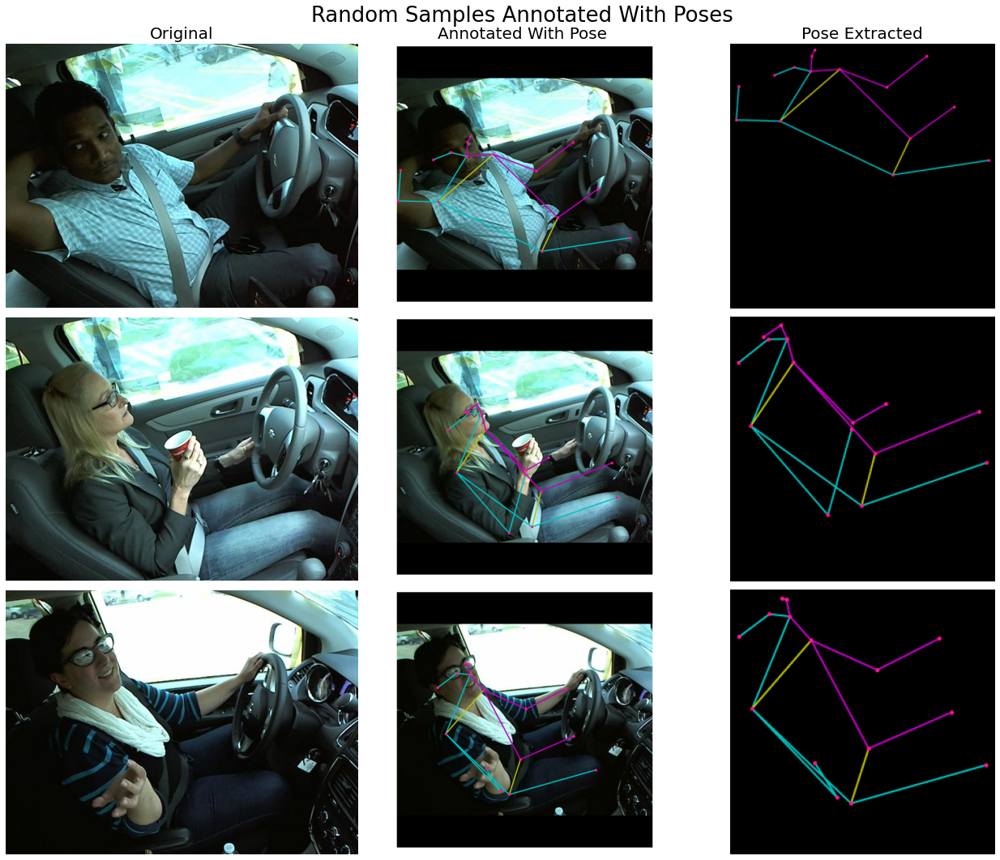

In [249]:
%matplotlib inline
# reset matplotlib's backend in case the previous cell left the Agg backend active.
vizualizer.display_poses(rows=3)

## Step 5: Generate Feature Vectors

In [190]:
%%time  
# faces, original_images, poses, y, filenames = load_data(30, other_types=[enums.ImageTypes.ORIGINAL, enums.ImageTypes.POSE, enums.ImageTypes.FACE], included_labels=config.included_labels)
feature_extractor = feature_helpers.FeatureExtractor(config, face_config, pose_config, tqdm)
data = feature_extractor.load_data(image_types=IMAGE_TYPES, sample_type=enums.SampleType.TRAIN_TEST_VALIDATION, shuffle=True)

# load existing features and re-generate them only if needed.
features_list = feature_extractor.load_feature_vectors(config.FEATURE_VECTORS_FOLDER, data[enums.DataColumn.FILENAME.value], data[enums.DataColumn.LABEL.value])

Loading 6000 samples:   0%|          | 0/6000 [00:00<?, ?samples/s]

load_data::df cols:Index(['filename', 'label', 'original', 'pose', 'face'], dtype='object')


Loading feature vectors:   0%|          | 0/6000 [00:00<?, ?images/s]

CPU times: user 8min 53s, sys: 1min 47s, total: 10min 40s
Wall time: 2min 22s


In [124]:
%%time
hog_features, hogs = feature_extractor.get_hog_features(data[enums.ImageTypes.FACE.name.lower()])

Building HOG Features:   0%|          | 0/6000 [00:00<?, ?images/s]

CPU times: user 4min 44s, sys: 11.4 s, total: 4min 55s
Wall time: 5min 15s


In [125]:
%%time
pixel_features = feature_extractor.get_pixel_features(data[enums.ImageTypes.FACE.name.lower()])

Building Pixel Features:   0%|          | 0/6000 [00:00<?, ?images/s]

CPU times: user 796 ms, sys: 1.65 s, total: 2.45 s
Wall time: 3.41 s


In [126]:
%%time
# GPU does not seems to help much.
cnn_features = feature_extractor.get_cnn_features(data[enums.ImageTypes.ORIGINAL.name.lower()], device='cpu')

Building ResNet152 Features:   0%|          | 0/6000 [00:00<?, ?images/s]

CPU times: user 2h 52min 49s, sys: 31min 37s, total: 3h 24min 26s
Wall time: 41min


In [127]:
%%time
canny_features, cannies = feature_extractor.get_canny_features(data[enums.ImageTypes.FACE.name.lower()])

Building Edge Features:   0%|          | 0/6000 [00:00<?, ?images/s]

CPU times: user 6 s, sys: 4.08 s, total: 10.1 s
Wall time: 9.6 s


In [128]:
%%time
pose_features = feature_extractor.get_pixel_features(data[enums.ImageTypes.POSE.name.lower()])

Building Pixel Features:   0%|          | 0/6000 [00:00<?, ?images/s]

CPU times: user 1.66 s, sys: 5 s, total: 6.67 s
Wall time: 12.3 s


In [ ]:
%%time
# body_parts_features = feature_extractor.get_body_part_features(
#     config.TRAIN_DATA, data[enums.DataColumn.LABEL.name.lower()], data[enums.DataColumn.FILENAME.name.lower()])

In [187]:
eye_count = feature_extractor.detect_eyes(config.TRAIN_DATA, data[enums.DataColumn.LABEL.name.lower()], data[enums.DataColumn.FILENAME.name.lower()])

Getting eye counts:   0%|          | 0/6000 [00:00<?, ?images/s]

In [189]:
def eye_summary(eye_count):
    df = pd.DataFrame(eye_count, columns=['count'])
    print(f'0: {df[df["count"] == 0].shape[0]}, 1: {df[df["count"] == 1].shape[0]}, 2: {df[df["count"] == 2].shape[0]}')
          
eye_summary(eye_count)

0: 4721, 1: 1157, 2: 115


In [152]:
%%time
# Save the generated feature vectors.
features_list = [pixel_features, hog_features, cnn_features, canny_features, pose_features, body_parts_features]
feature_extractor.save_feature_vectors(config.FEATURE_VECTORS_FOLDER, data['filename'], data['label'], features_list)

Saving feature vectors:   0%|          | 0/6000 [00:00<?, ?images/s]

CPU times: user 11.1 s, sys: 11.3 s, total: 22.3 s
Wall time: 28.1 s


In [155]:
print(f'Loaded {data.shape[0]} samples.')
print(f'hog_features:{hog_features.shape}, hog_features.min:{np.min(hog_features)}, hog_features.max:{np.max(hog_features)}')
print(f'pixel_features:{pixel_features.shape}, pixel_features.min:{np.min(pixel_features)}, pixel_features.max:{np.max(pixel_features)}')
print(f'cnn_features:{cnn_features.shape}, cnn_features.min:{np.min(cnn_features)}, cnn_features.max:{np.max(cnn_features)}')
print(f'canny_features:{canny_features.shape}, canny_features.min:{np.min(canny_features)}, canny_features.max:{np.max(canny_features)}')
print(f'pose_features:{pose_features.shape}, pose_features.min:{np.min(pose_features)}, pose_features.max:{np.max(pose_features)}')
# print(f'body_parts_features.min:{np.min(body_parts_features)}, body_parts_features.max:{np.max(body_parts_features)}')
print()


Loaded 6000 samples.
hog_features:(6000, 5776), hog_features.min:0.0, hog_features.max:1.0
pixel_features:(6000, 25600), pixel_features.min:0.0, pixel_features.max:0.9999000430107117
cnn_features:(6000, 2048), cnn_features.min:0.0, cnn_features.max:1.607669472694397
canny_features:(6000, 25600), canny_features.min:0, canny_features.max:255
pose_features:(6000, 65536), pose_features.min:0.0, pose_features.max:0.6640035510063171



## Step 6. Visualize Features

Loading 10 samples:   0%|          | 0/10 [00:00<?, ?samples/s]

Building HOG Features:   0%|          | 0/10 [00:00<?, ?images/s]

Building Edge Features:   0%|          | 0/10 [00:00<?, ?images/s]

Loading image:   0%|          | 0/52 [00:00<?, ?images/s]

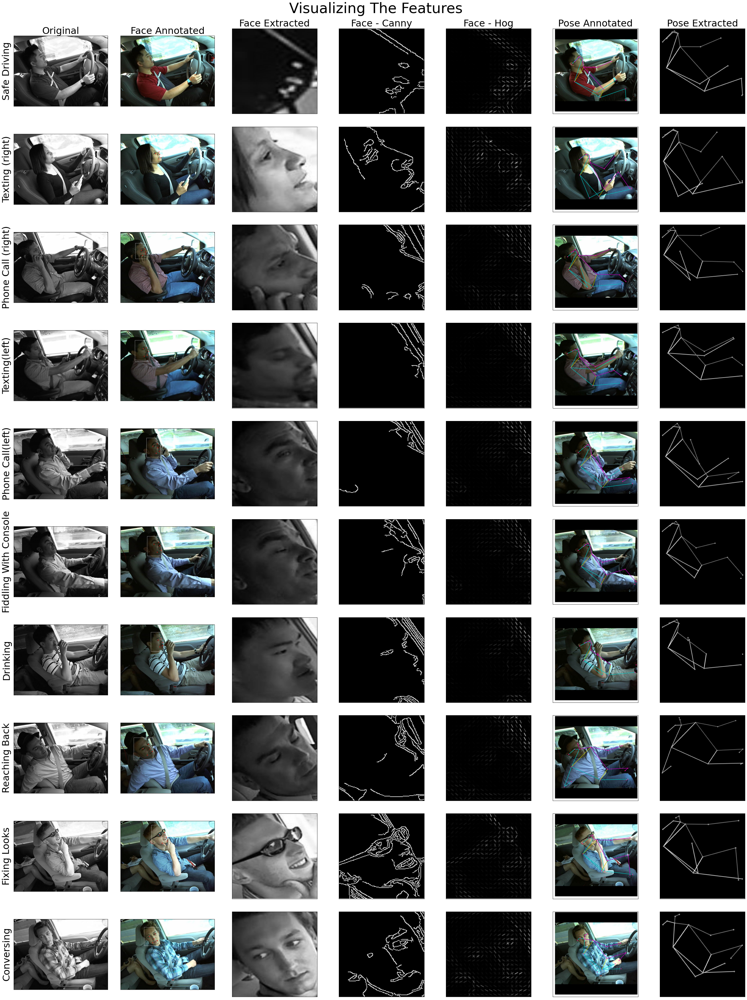

In [279]:
vizualizer.plot_features(included_labels=config.class_dict.keys())

In [5]:
# vizualizer.show_scores_distributions()

  0%|          | 0/5400 [00:00<?, ?it/s]

/Users/rasentha/mids/w281/project/w281-fall2022-section2-team3/notebooks/viz.py:312: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='right')


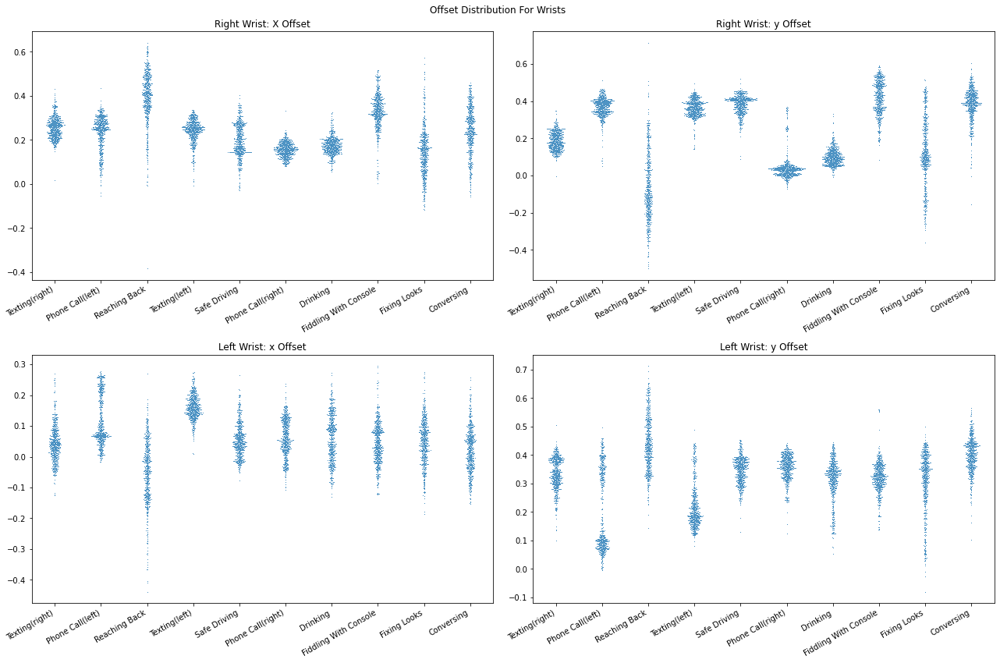

In [ ]:
vizualizer.plot_keypoints_relative_positions()

## References
<span id="cite_mtcnn">X. He, P. Wang, Z. Zhao, Y. Zhao and F. Su, "MTCNN with Weighted Loss Penalty and Adaptive Threshold Learning for Facial Attribute Prediction," 2019 IEEE International Conference on Multimedia & Expo Workshops (ICMEW), 2019, pp. 180-185, doi: 10.1109/ICMEW.2019.00-90.</span>

<span id="cite_mobilenet">Sandler, M., Howard, A., Zhu, M., et al. (2018) Mobilenetv2: Inverted Residuals and Linear Bottlenecks. Proceedings of the IEEE Conference on Computer Vision and Pattern Recognition, Salt Lake City, 18-23 June 2018, 4510-4520.
https://doi.org/10.1109/CVPR.2018.00474</span>